<div style="width: 100%; overflow: hidden;">
    <div style="width: 150px; float: left;"> <img src="https://raw.githubusercontent.com/DataForScience/Networks/master/data/D4Sci_logo_ball.png" alt="Data For Science, Inc" align="left" border="0" width=150px> </div>
    <div style="float: left; margin-left: 10px;"> <h1>Generative AI with OpenAI API</h1>
<h1>DALL-E</h1>
        <p>Bruno Gonçalves<br/>
        <a href="http://www.data4sci.com/">www.data4sci.com</a><br/>
            @bgoncalves, @data4sci</p></div>
</div>

In [1]:
import numpy as np

import matplotlib
import matplotlib.pyplot as plt 
import matplotlib.image as mpimg

from IPython.display import Image

import openai
from openai import OpenAI

import os

import requests
import shutil

import tqdm as tq
from tqdm.notebook import tqdm

import watermark

%load_ext watermark
%matplotlib inline

We start by printing out the versions of the libraries we're using for future reference

In [2]:
%watermark -n -v -m -g -iv

Python implementation: CPython
Python version       : 3.11.7
IPython version      : 8.12.3

Compiler    : Clang 14.0.6 
OS          : Darwin
Release     : 23.4.0
Machine     : arm64
Processor   : arm
CPU cores   : 16
Architecture: 64bit

Git hash: 5217868ae783ab0315a9d79f2e1ac0fb25095003

openai    : 1.20.0
requests  : 2.31.0
tqdm      : 4.66.2
matplotlib: 3.8.0
numpy     : 1.26.4
watermark : 2.4.3



Load default figure style

In [3]:
plt.style.use('d4sci.mplstyle')
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

Get the API key

In [4]:
client = OpenAI()

The directory where we will be saving our images

In [5]:
image_dir = "./images/"

# Generate an image based on a Prompt

In [6]:
prompt = "Innovate a movie poster for a sci-fi film titled ‘Quantum Space World’"

Make the request

In [7]:
%%time
response = client.images.generate(
    model='dall-e-3',
    prompt=prompt,
    n=1,
    size="1024x1024",
    response_format="url",
)

CPU times: user 6.81 ms, sys: 6.95 ms, total: 13.8 ms
Wall time: 12 s


The response includes the URL of the image so that we can download it

In [8]:
print(response)

ImagesResponse(created=1716341663, data=[Image(b64_json=None, revised_prompt="Design a movie poster for an exciting science fiction film named ‘Quantum Space World’. The main feature of the poster should be a vibrant depiction of an advanced spaceship traveling through a surreal space environment filled with quantum spirals and bizarrely shaped celestial bodies. Include the film title prominently in futuristic lettering at the top. At the bottom, add credits for various roles, all under the tagline 'A Journey Through the Unexplored Dimensions'. Please maintain a balance between darkness and vibrant colors to highlight the mysterious and thrilling nature of the movie.", url='https://oaidalleapiprodscus.blob.core.windows.net/private/org-cEu7KbLexcTF7u2YnTgg3tFV/user-OYeHJ0J19d8sU7MeuMaFfyf7/img-Y97FB94sOPAnvqniLYuxCnch.png?st=2024-05-22T00%3A34%3A23Z&se=2024-05-22T02%3A34%3A23Z&sp=r&sv=2021-08-06&sr=b&rscd=inline&rsct=image/png&skoid=6aaadede-4fb3-4698-a8f6-684d7786b067&sktid=a48cca56-e6

Extract the URL from the response

In [9]:
image_url = response.data[0].url

Define a utility function to help us download the image file

In [10]:
def download_file(url, filename):
    with requests.get(url, stream=True) as r:
        total_length = int(r.headers.get("Content-Length"))
        with tqdm.wrapattr(r.raw, "read", total=total_length, desc=filename) as raw:
            with open(filename, 'wb')as output:
                shutil.copyfileobj(raw, output)

Download the image

In [11]:
image_filename = os.path.join(image_dir, 'movie.png')
download_file(image_url, image_filename)

./images/movie.png:   0%|          | 0/3162696 [00:00<?, ?it/s]

And display it

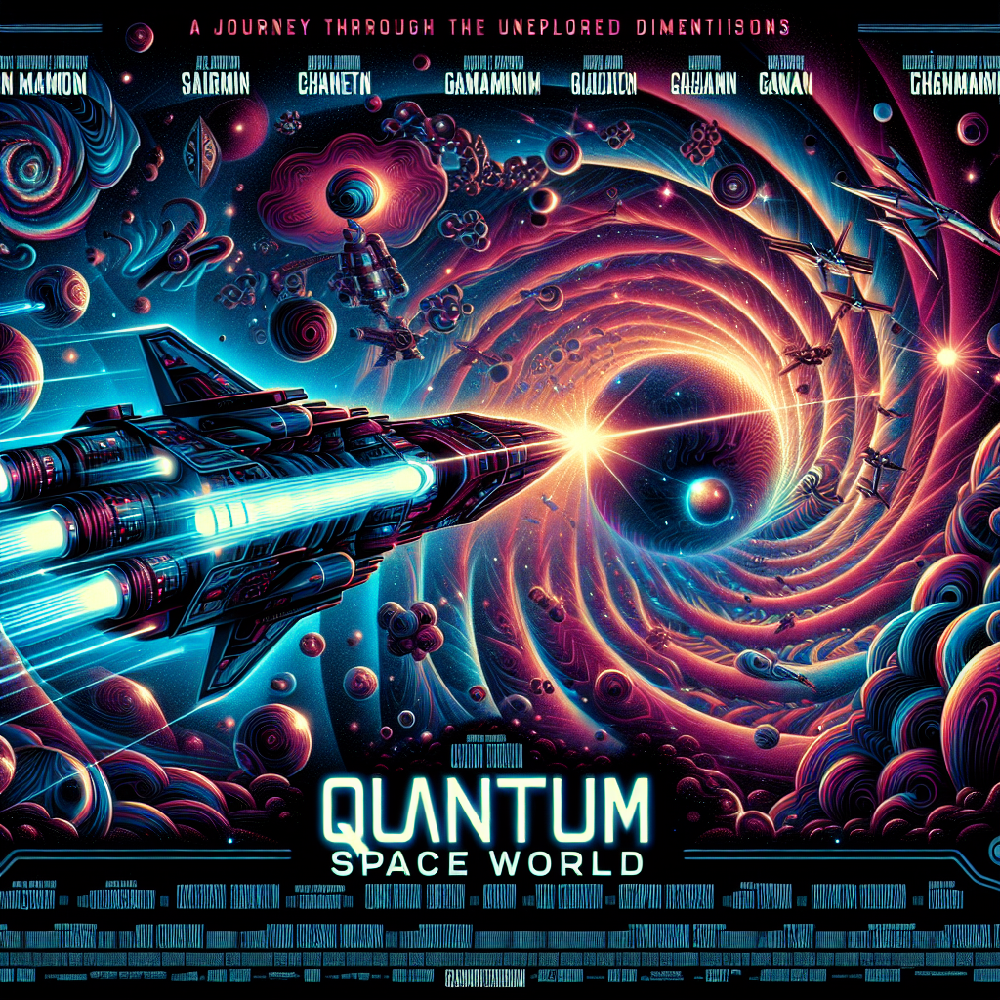

In [12]:
Image(filename=image_filename)

# Image Variations

To generate variations, we must upload an existing image. Let's try out a photo

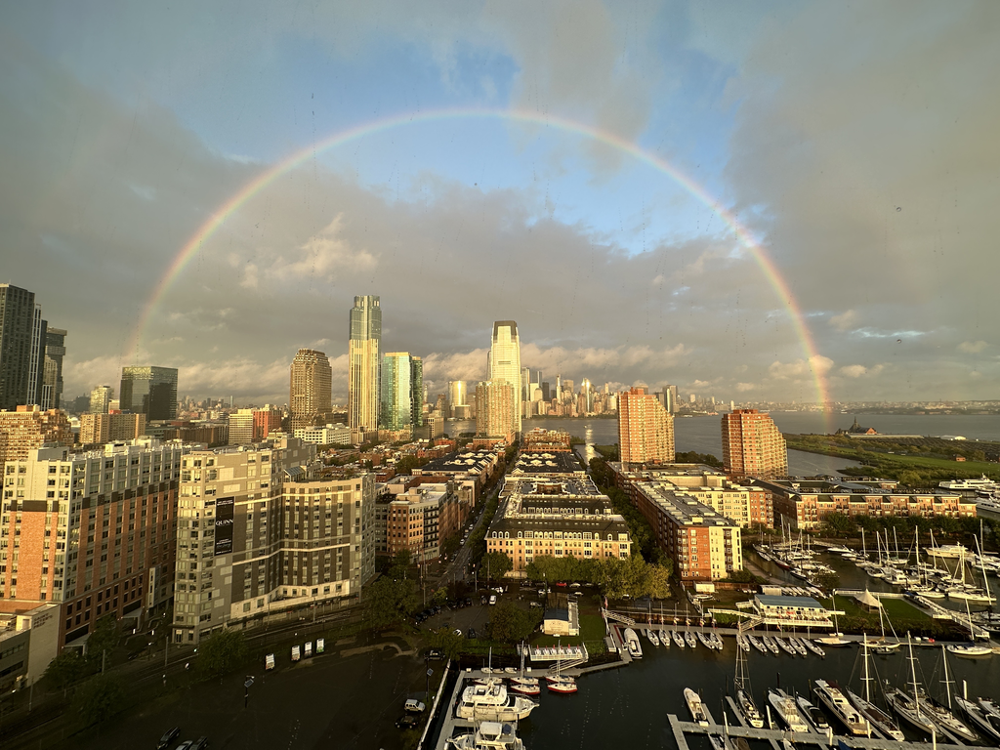

In [13]:
Image(filename='images/rainbow.png')

In [19]:
%%time
response = client.images.create_variation(
    image=open('images/rainbow.png', 'rb'),
    n=3,
    size="1024x1024",
    response_format="url",
)

CPU times: user 11.7 ms, sys: 7.75 ms, total: 19.4 ms
Wall time: 11.9 s


We requested 3 variants so we get 3 URLs back

In [20]:
print(response)

ImagesResponse(created=1716341806, data=[Image(b64_json=None, revised_prompt=None, url='https://oaidalleapiprodscus.blob.core.windows.net/private/org-cEu7KbLexcTF7u2YnTgg3tFV/user-OYeHJ0J19d8sU7MeuMaFfyf7/img-jsx0OtsA9hJdJ7MiaJ8SGtUJ.png?st=2024-05-22T00%3A36%3A45Z&se=2024-05-22T02%3A36%3A45Z&sp=r&sv=2021-08-06&sr=b&rscd=inline&rsct=image/png&skoid=6aaadede-4fb3-4698-a8f6-684d7786b067&sktid=a48cca56-e6da-484e-a814-9c849652bcb3&skt=2024-05-21T10%3A15%3A38Z&ske=2024-05-22T10%3A15%3A38Z&sks=b&skv=2021-08-06&sig=tByKLyVEmftED/ryqRXnhxtujFH7%2BLA8pmYDZIwI2MQ%3D'), Image(b64_json=None, revised_prompt=None, url='https://oaidalleapiprodscus.blob.core.windows.net/private/org-cEu7KbLexcTF7u2YnTgg3tFV/user-OYeHJ0J19d8sU7MeuMaFfyf7/img-s8YukVjqY5m924ODXhrqJ8BH.png?st=2024-05-22T00%3A36%3A46Z&se=2024-05-22T02%3A36%3A46Z&sp=r&sv=2021-08-06&sr=b&rscd=inline&rsct=image/png&skoid=6aaadede-4fb3-4698-a8f6-684d7786b067&sktid=a48cca56-e6da-484e-a814-9c849652bcb3&skt=2024-05-21T10%3A15%3A38Z&ske=2024-05-22T

All of which we download

In [21]:
variant_files = []

for i, variation in enumerate(response.data):
    variant_url = variation.url
    variant_filename = os.path.join(image_dir, 'rainbow_%u.png' % i)
    variant_files.append(variant_filename)
    download_file(variant_url, variant_filename)

./images/rainbow_0.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

./images/rainbow_1.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

./images/rainbow_2.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

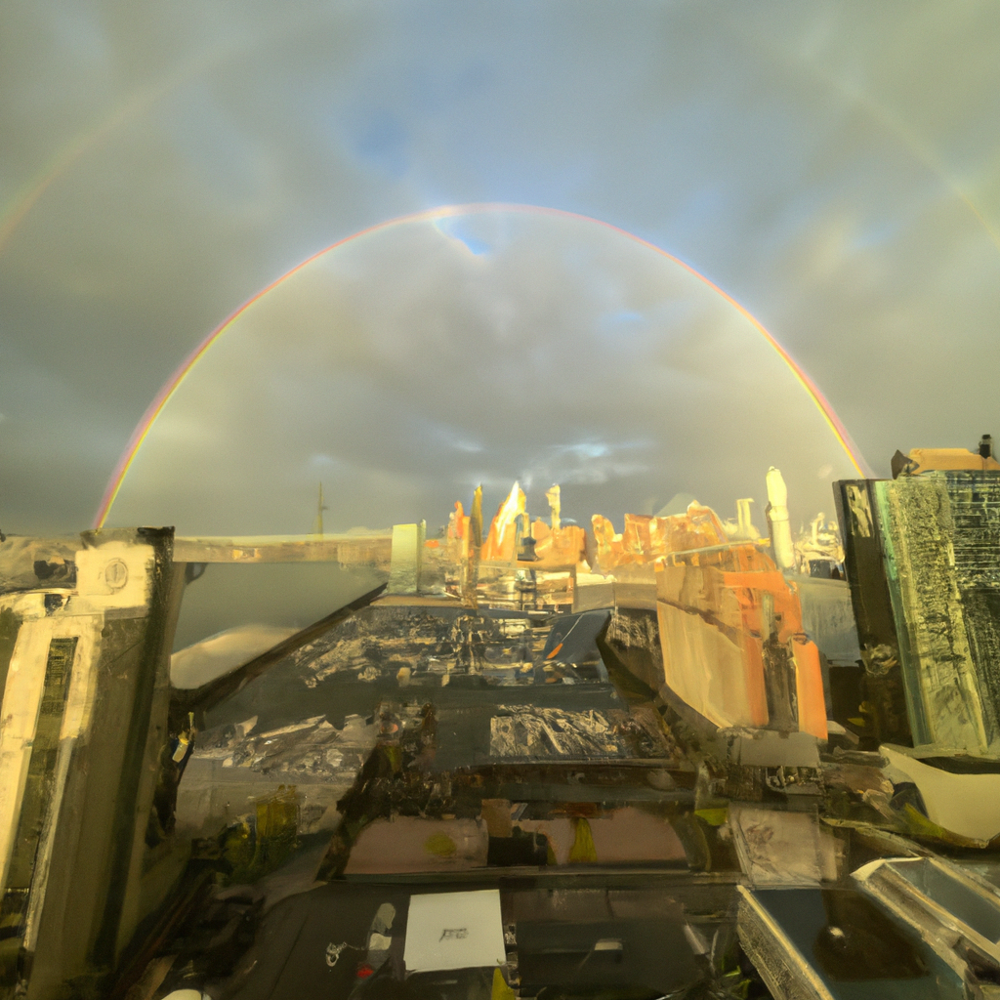

In [22]:
Image(variant_files[0])

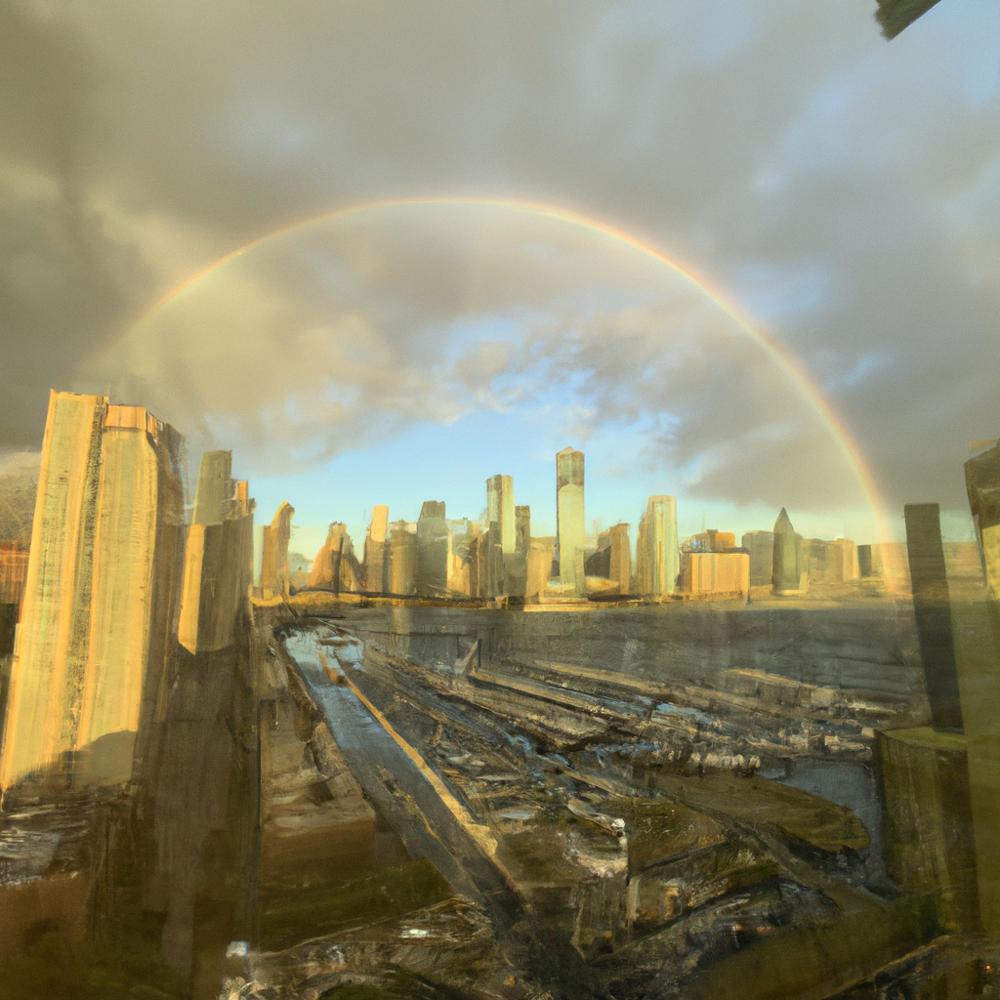

In [23]:
Image(variant_files[1])

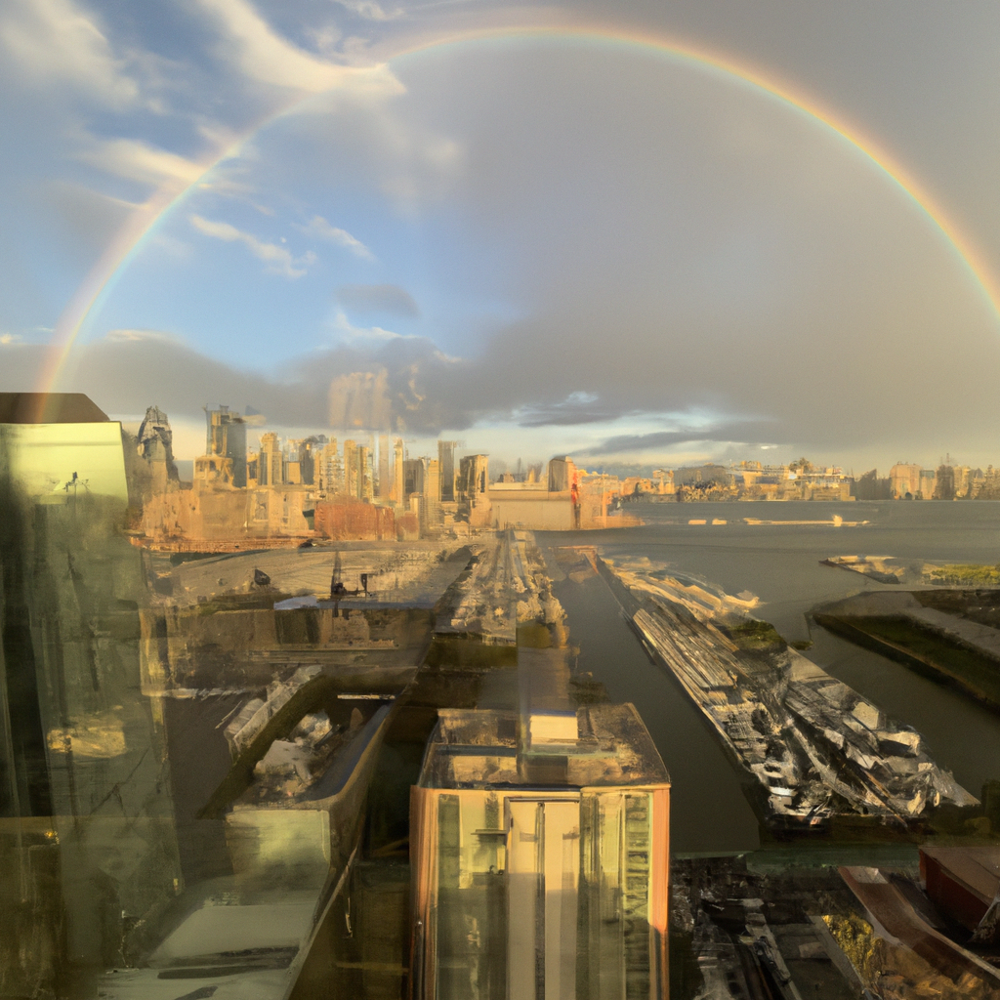

In [24]:
Image(variant_files[2])

# Edits

To have DALL-E edit the image, we need to specify a mask. This is just an image with transparent pixels where we want the edits to take place. We start with our original image

In [25]:
mask = mpimg.imread(image_filename)
width, height, depth = mask.shape

And remove the bottom half of the image.

In [26]:
mask = mask.reshape(width*height, depth)

# Add the alpha channel as opaque throughout
mask = np.append(mask, np.ones((width*height, 1)), axis=1)

for x in range(width):
    for y in range(height // 2, height):
        # set alpha (A) to zero to turn pixel transparent
        mask[x+y*width] = (0, 0, 0, 0)

mask = mask.reshape(width, height, depth+1)

# save the mask
mask_filename = os.path.join(image_dir, "bottom_half_mask.png")
mpimg.imsave(mask_filename, mask)

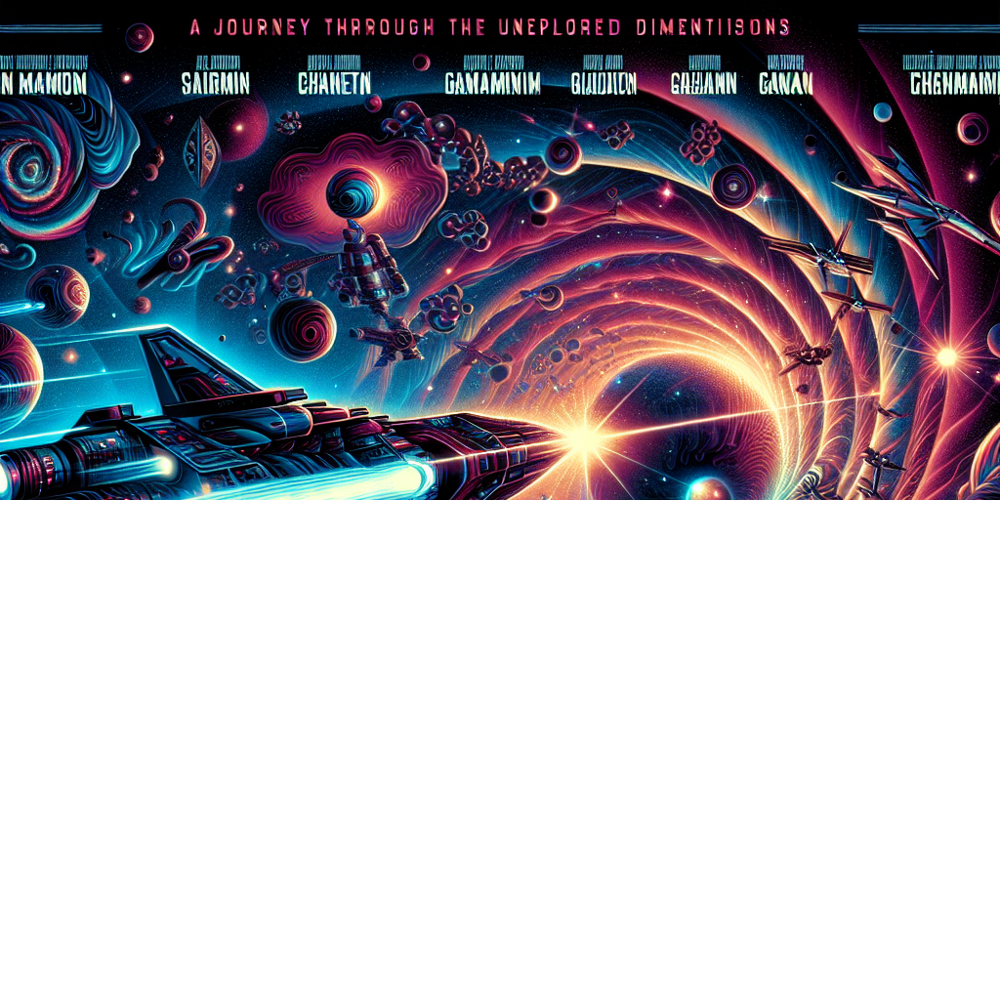

In [27]:
Image(mask_filename)

### Perform Edit

Now we supply our image, prompt and mask to the API to get 3 examples of edits to our image

In [29]:
%%time
response = client.images.edit(
    image=open(image_filename, "rb"), 
    mask=open(mask_filename, "rb"),
    prompt=prompt, 
    n=1,
    size="1024x1024",
    response_format="url",
)

CPU times: user 22.9 ms, sys: 26.7 ms, total: 49.6 ms
Wall time: 22.6 s


In [30]:
response

ImagesResponse(created=1716341869, data=[Image(b64_json=None, revised_prompt=None, url='https://oaidalleapiprodscus.blob.core.windows.net/private/org-cEu7KbLexcTF7u2YnTgg3tFV/user-OYeHJ0J19d8sU7MeuMaFfyf7/img-oZwNXvQgX0DpNETBHDohPX5s.png?st=2024-05-22T00%3A37%3A49Z&se=2024-05-22T02%3A37%3A49Z&sp=r&sv=2021-08-06&sr=b&rscd=inline&rsct=image/png&skoid=6aaadede-4fb3-4698-a8f6-684d7786b067&sktid=a48cca56-e6da-484e-a814-9c849652bcb3&skt=2024-05-21T10%3A09%3A17Z&ske=2024-05-22T10%3A09%3A17Z&sks=b&skv=2021-08-06&sig=GlS1rU5a2txH1xZE/Xywp2EpnUrJc7H1xONDwNSpDsg%3D')])

In [31]:
edited_image_filename = os.path.join(image_dir, "edited_image.png")
edited_image_url = response.data[0].url  # extract image URL from response

download_file(edited_image_url, edited_image_filename)

./images/edited_image.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

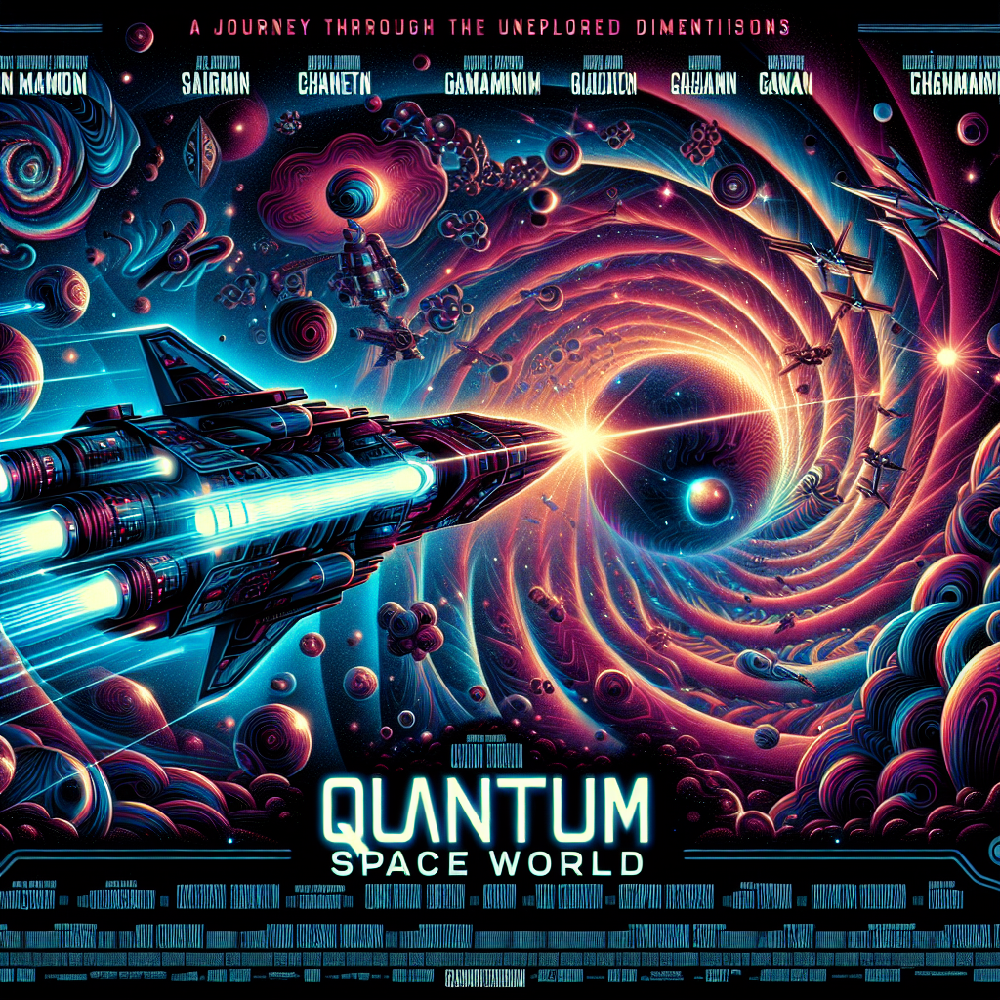

In [32]:
Image(image_filename)

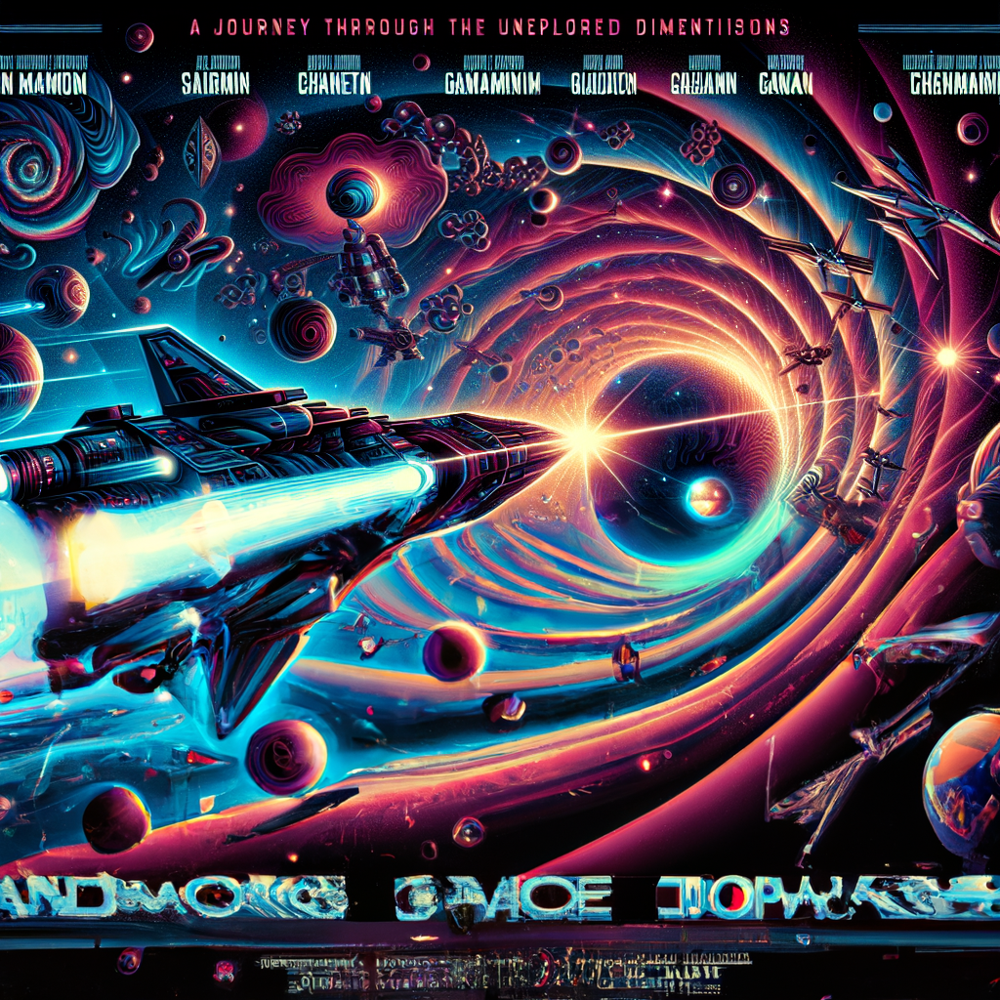

In [33]:
Image(edited_image_filename)

# Generate Prompt

In [34]:
%%time
response = client.chat.completions.create(
  model="gpt-4o",
  messages=[
        {"role": "system", "content": """You're a brilliant graphic designer. 
        Generate an precise prompt for DALL-E that has at most 1000 characters."""
        },
        {"role": "user", "content": prompt},
    ]
)

CPU times: user 7.53 ms, sys: 2.34 ms, total: 9.87 ms
Wall time: 3.52 s


In [35]:
prompt

'Innovate a movie poster for a sci-fi film titled ‘Quantum Space World’'

In [36]:
print(response.choices[0].message.content)

Create a stunning sci-fi movie poster for the film titled 'Quantum Space World.' The poster should feature a futuristic cityscape with towering skyscrapers glowing with neon lights, seamlessly blending into an expansive cosmic backdrop filled with stars, nebulae, and swirling galaxies. In the foreground, include a diverse group of characters wearing advanced, high-tech space suits, looking determined and ready for action. Integrate elements of quantum physics such as floating particles and fractal designs subtly into the environment. Use a bold, metallic font for the movie title with a subtle glow, and position it prominently at the top of the poster. Add the tagline "Beyond Reality, Beyond Imagination" in smaller text below the title. The overall color scheme should include deep blues, vibrant purples, and shimmering silvers, creating a sense of wonder and adventure.


In [37]:
expanded_prompt = response.choices[0].message.content

In [38]:
len(expanded_prompt)

880

In [40]:
response = client.images.generate(
    prompt=expanded_prompt[:1000],
    n=3,
    size="1024x1024",
    response_format="url",
)

In [41]:
filenames = []

for i in range(3):
    expanded_image_url = response.data[i].url

    expanded_image_filename = os.path.join(image_dir, 'expanded_movie_%u.png' % i)
    download_file(expanded_image_url, expanded_image_filename)
    filenames.append(expanded_image_filename)

./images/expanded_movie_0.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

./images/expanded_movie_1.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

./images/expanded_movie_2.png:   0%|          | 0/3147981 [00:00<?, ?it/s]

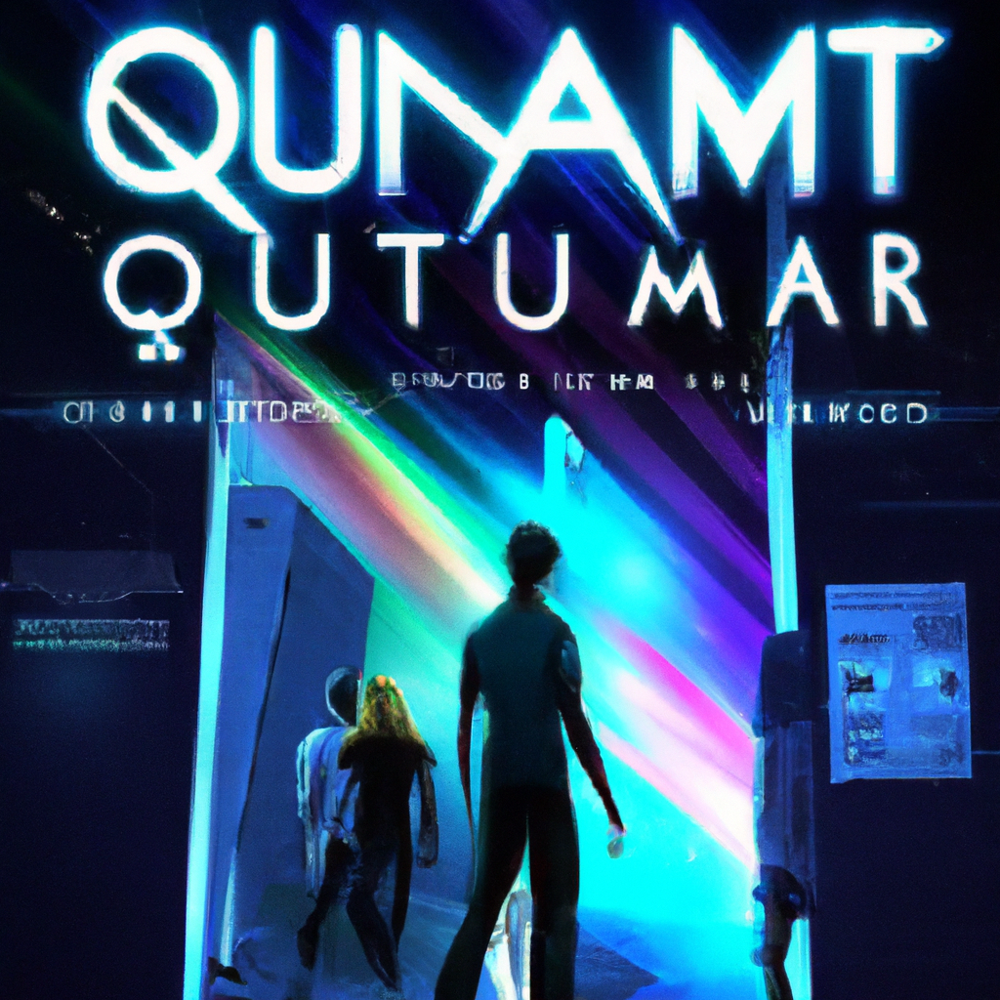

In [42]:
Image(filenames[0])

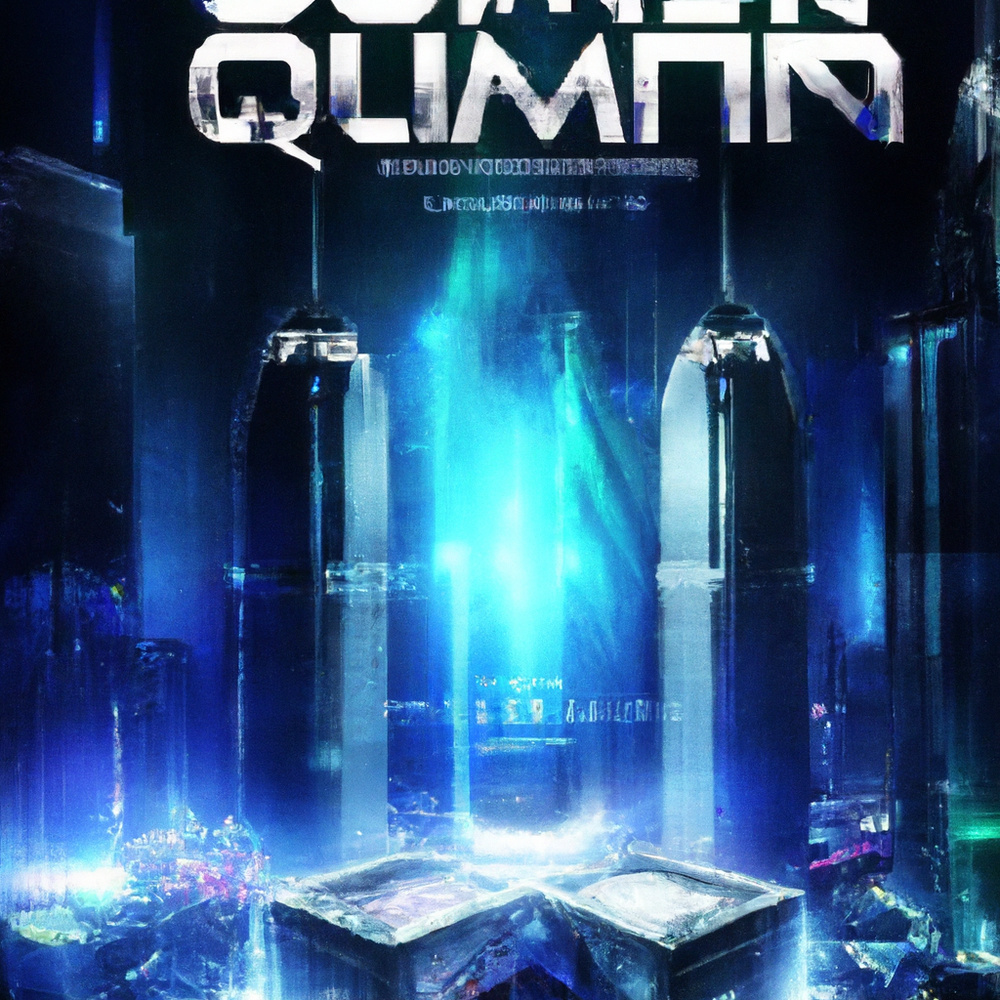

In [43]:
Image(filenames[1])

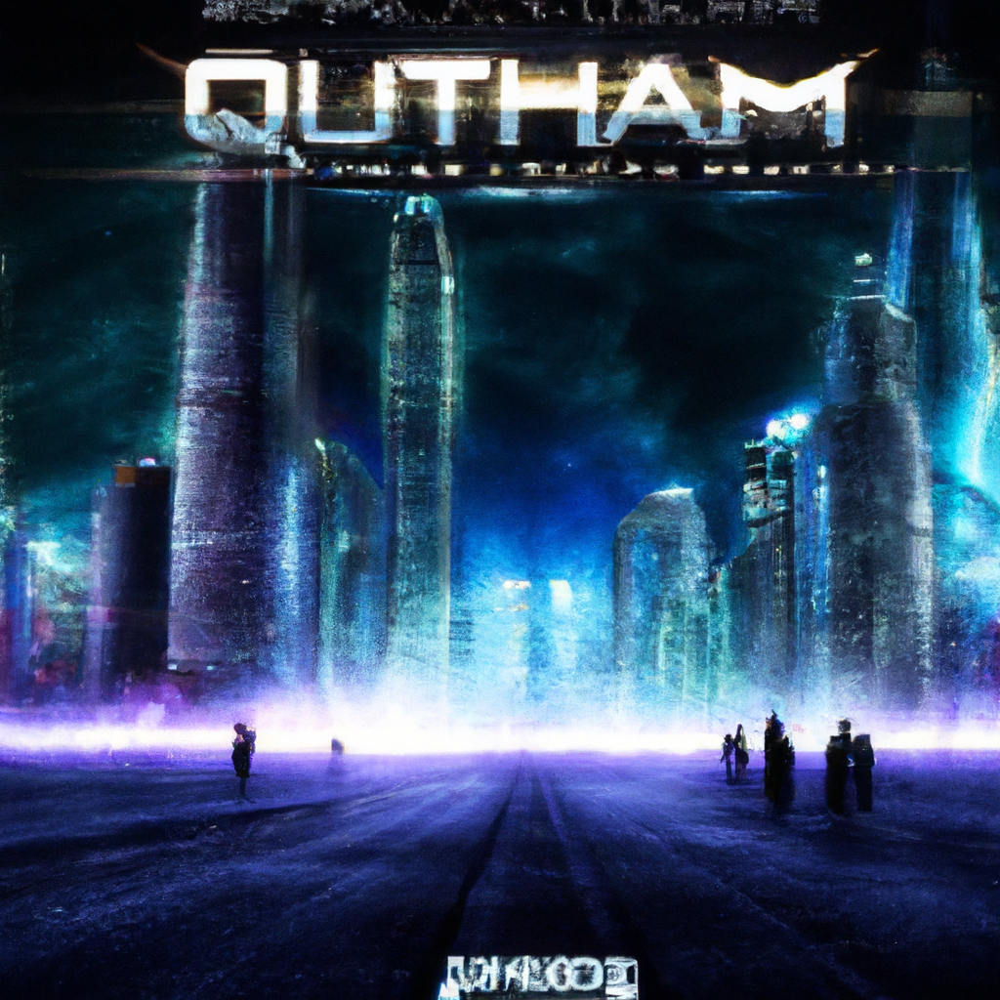

In [44]:
Image(filenames[2])

<center>
     <img src="https://raw.githubusercontent.com/DataForScience/Networks/master/data/D4Sci_logo_full.png" alt="Data For Science, Inc" align="center" border="0" width=300px> 
</center>